<a href="https://colab.research.google.com/github/shijisimon/EDA/blob/main/Indianstates.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [6]:
# importing packages
import pandas as pd
from pandas_profiling import ProfileReport
import numpy as np
from scipy.interpolate import interp1d
from numpy import array
import matplotlib as mpl

# for plots
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.dates import date2num
from mpl_toolkits.basemap import Basemap

# for date and time processing
import datetime

# for statistical graphs
import seaborn as sns

In [3]:
cities = pd.read_csv('/content/cities_r2.csv')
cities

,name_of_city,state_code,state_name,dist_code,population_total,population_male,population_female,0-6_population_total,0-6_population_male,0-6_population_female,...,literates_female,sex_ratio,child_sex_ratio,effective_literacy_rate_total,effective_literacy_rate_male,effective_literacy_rate_female,location,total_graduates,male_graduates,female_graduates
0,Abohar,3,PUNJAB,9,145238,76840,68398,15870,8587,7283,...,44972,890,848,79.86,85.49,73.59,"30.1452928,74.1993043",16287,8612,7675
1,Achalpur,27,MAHARASHTRA,7,112293,58256,54037,11810,6186,5624,...,43086,928,909,91.99,94.77,89.00,"21.257584,77.5086754",8863,5269,3594
2,Adilabad,28,ANDHRA PRADESH,1,117388,59232,58156,13103,6731,6372,...,37660,982,947,80.51,88.18,72.73,"19.0809075,79.560344",10565,6797,3768
3,Adityapur,20,JHARKHAND,24,173988,91495,82493,23042,12063,10979,...,54515,902,910,83.46,89.98,76.23,"22.7834741,86.1576889",19225,12189,7036
4,Adoni,28,ANDHRA PRADESH,21,166537,82743,83794,18406,9355,9051,...,45089,1013,968,68.38,76.58,60.33,"15.6322227,77.2728368",11902,7871,4031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
488,Vizianagaram,28,ANDHRA PRADESH,12,227533,111596,115937,20487,10495,9992,...,80306,1039,952,81.85,88.18,75.80,"18.1066576,83.3955506",30656,19173,11483
489,Warangal,28,ANDHRA PRADESH,9,620116,310400,309716,55392,28434,26958,...,217136,998,948,84.16,91.54,76.79,"17.9689008,79.5940544",109613,69507,40106
490,Wardha,27,MAHARASHTRA,8,105543,53241,52302,9754,5139,4615,...,43339,982,898,94.05,97.19,90.88,"20.745319,78.6021946",19363,10645,8718
491,Yamunanagar,6,HARYANA,3,216628,115404,101224,22905,12556,10349,...,74255,877,824,85.91,89.61,81.71,"30.1290485,77.2673901",29803,14349,15454


In [9]:
profile = ProfileReport(cities,title='Pandas Profiling Report')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
cities.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 493 entries, 0 to 492
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   name_of_city                    493 non-null    object 
 1   state_code                      493 non-null    int64  
 2   state_name                      493 non-null    object 
 3   dist_code                       493 non-null    int64  
 4   population_total                493 non-null    int64  
 5   population_male                 493 non-null    int64  
 6   population_female               493 non-null    int64  
 7   0-6_population_total            493 non-null    int64  
 8   0-6_population_male             493 non-null    int64  
 9   0-6_population_female           493 non-null    int64  
 10  literates_total                 493 non-null    int64  
 11  literates_male                  493 non-null    int64  
 12  literates_female                493 

<ipython-input-17-afaf0964dd73>:5: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='both', color='Black',linestyle='-')


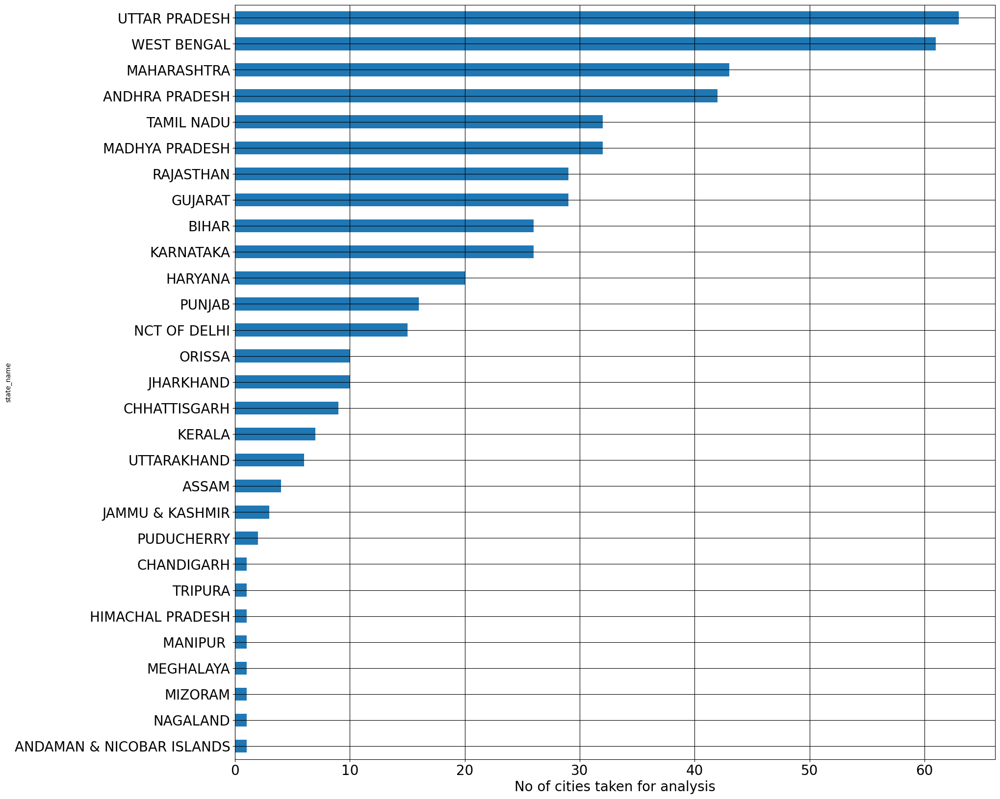

In [17]:
# A bar chart to show from which states, how many cities are taken for examination.
fig = plt.figure(figsize=(20,20))
states = cities.groupby('state_name')['name_of_city'].count().sort_values(ascending=True)
states.plot(kind="barh", fontsize = 20)
plt.grid(b=True, which='both', color='Black',linestyle='-')
plt.xlabel('No of cities taken for analysis', fontsize = 20)
plt.show ()
# we can see states like UP and WB are given high priority by taking more than 60 cities.

In [18]:
#Top 10 populous city (Extracting Co-ordinates details from the provided data)
cities['latitude'] = cities['location'].apply(lambda x: x.split(',')[0])
cities['longitude'] = cities['location'].apply(lambda x: x.split(',')[1])
cities.head(1)

,name_of_city,state_code,state_name,dist_code,population_total,population_male,population_female,0-6_population_total,0-6_population_male,0-6_population_female,...,child_sex_ratio,effective_literacy_rate_total,effective_literacy_rate_male,effective_literacy_rate_female,location,total_graduates,male_graduates,female_graduates,latitude,longitude
0,Abohar,3,PUNJAB,9,145238,76840,68398,15870,8587,7283,...,848,79.86,85.49,73.59,"30.1452928,74.1993043",16287,8612,7675,30.1452928,74.1993043


In [19]:
# A table to show top 10 cities with most population
print("The Top 10 Cities sorted according to the Total Population (Descending Order)")
top_pop_cities = cities.sort_values(by='population_total',ascending=False)
top10_pop_cities=top_pop_cities.head(10)
top10_pop_cities

The Top 10 Cities sorted according to the Total Population (Descending Order)


,name_of_city,state_code,state_name,dist_code,population_total,population_male,population_female,0-6_population_total,0-6_population_male,0-6_population_female,...,child_sex_ratio,effective_literacy_rate_total,effective_literacy_rate_male,effective_literacy_rate_female,location,total_graduates,male_graduates,female_graduates,latitude,longitude
185,Greater Mumbai,27,MAHARASHTRA,99,12478447,6736815,5741632,1139146,599007,540139,...,902,90.28,93.32,86.70,"19.0760,72.8777",1802371,964964,837407,19.0760,72.8777
141,Delhi,7,NCT OF DELHI,99,11007835,5871362,5136473,1209275,647938,561337,...,866,87.60,91.44,83.20,"28.7041,77.1025",2221137,1210040,1011097,28.7041,77.1025
72,Bengaluru,29,KARNATAKA,18,8425970,4401299,4024671,862493,444639,417854,...,940,89.59,92.63,86.25,"12.9716,77.5946",1591163,908363,682800,12.9716,77.5946
184,Greater Hyderabad,28,ANDHRA PRADESH,99,6809970,3500802,3309168,725816,373794,352022,...,942,82.96,85.96,79.79,"17.3850,78.4867",1164149,685402,478747,17.3850,78.4867
7,Ahmadabad,24,GUJARAT,7,5570585,2935869,2634716,589076,317917,271159,...,853,89.62,93.96,84.81,"23.022505,72.5713621",769858,435267,334591,23.022505,72.5713621
119,Chennai,33,TAMIL NADU,2,4681087,2357633,2323454,418541,213084,205457,...,964,90.33,93.47,87.16,"13.0826802,80.2707184",879695,487428,392267,13.0826802,80.2707184
274,Kolkata,19,WEST BENGAL,16,4486679,2362662,2124017,300052,155475,144577,...,930,87.14,89.08,84.98,"22.572646,88.363895",818476,461615,356861,22.572646,88.363895
449,Surat,24,GUJARAT,25,4462002,2538243,1923759,531522,293208,238314,...,813,89.03,92.76,84.05,"21.1702401,72.8310607",278795,160566,118229,21.1702401,72.8310607
380,Pune,27,MAHARASHTRA,25,3115431,1602137,1513294,324572,171152,153420,...,896,91.61,95.13,87.91,"18.5204303,73.8567437",656508,349022,307486,18.5204303,73.8567437
225,Jaipur,8,RAJASTHAN,12,3073350,1619280,1454070,378788,204320,174468,...,854,84.34,90.61,77.41,"26.9124336,75.7872709",533148,319107,214041,26.9124336,75.7872709


Text(0.5, 1.0, 'Top 10 Populated Cities in India')

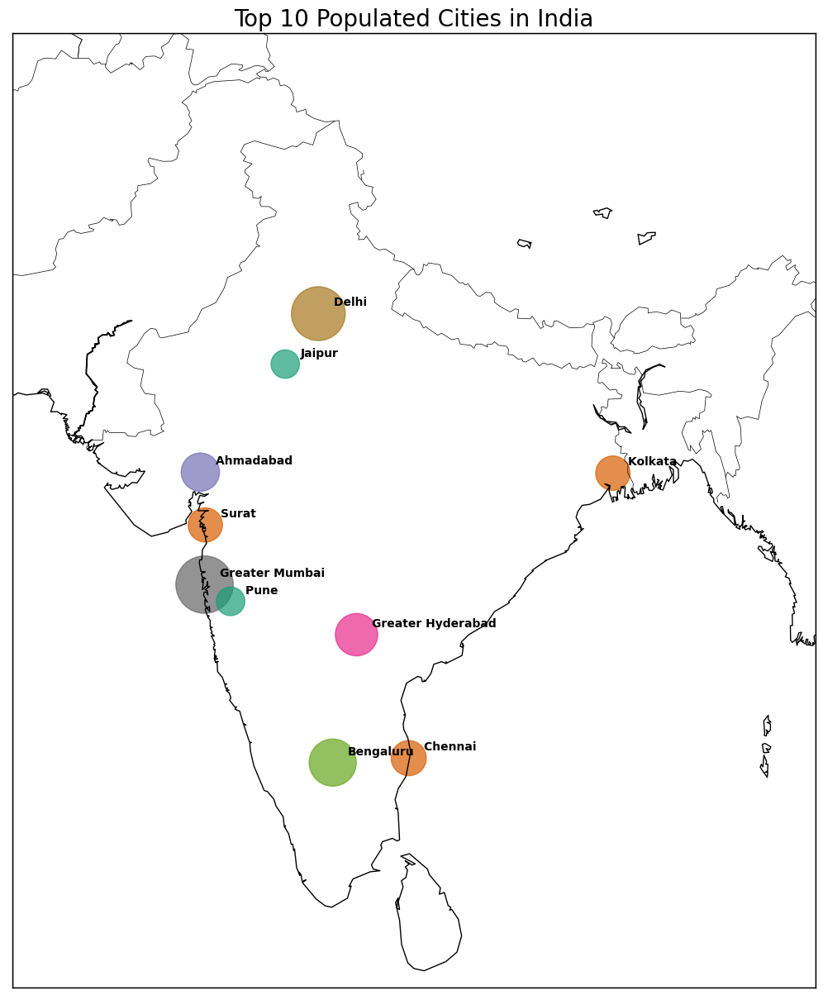

In [22]:
#Plotting these top 10 populous cities on India map. Circles are sized according to the 
# population of the respective city

plt.subplots(figsize=(20, 15))
map = Basemap(width=1200000,height=900000,projection='lcc',resolution='l',
                    llcrnrlon=67,llcrnrlat=5,urcrnrlon=99,urcrnrlat=37,lat_0=28,lon_0=77)

map.drawmapboundary ()
map.drawcountries ()
map.drawcoastlines ()

lg=array(top10_pop_cities['longitude'])
lt=array(top10_pop_cities['latitude'])
pt=array(top10_pop_cities['population_total'])
nc=array(top10_pop_cities['name_of_city'])

x, y = map(lg, lt)
population_sizes = top10_pop_cities["population_total"].apply(lambda x: int(x / 5000))
plt.scatter(x, y, s=population_sizes, marker="o", c=population_sizes, cmap=cm.Dark2, alpha=0.7)


for ncs, xpt, ypt in zip(nc, x, y):
    plt.text(xpt+60000, ypt+30000, ncs, fontsize=10, fontweight='bold')

plt.title('Top 10 Populated Cities in India',fontsize=20)

<ipython-input-23-fe140d77657d>:6: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='both', color='Black',linestyle='-')


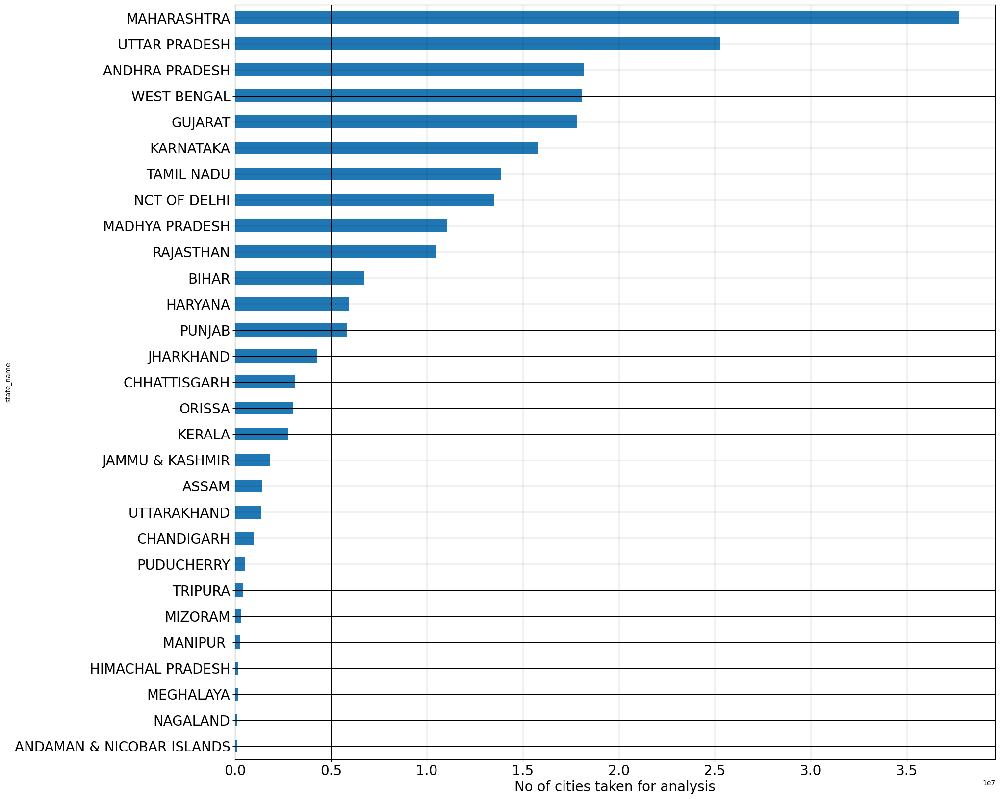

In [23]:
#Plotting Statewise cities to check which state have most population living in urban areas
# A bar chart to show the population of the states
fig = plt.figure(figsize=(20,20))
states = cities.groupby('state_name')['population_total'].sum().sort_values(ascending=True)
states.plot(kind="barh", fontsize = 20)
plt.grid(b=True, which='both', color='Black',linestyle='-')
plt.xlabel('No of cities taken for analysis', fontsize = 20)
plt.show ()
# we can see states like Maharashtra and UP have huge urban population



In [26]:
#Plotting every city on India map according to population
# Creating a function to plot the population data on real India map

def plot_map(sizes, colorbarValue):

    plt.figure(figsize=(19,20))
    f, ax = plt.subplots(figsize=(19, 20))

    # Setting up Basemap
    map = Basemap(width=5000000, height=3500000, resolution='l', projection='aea', llcrnrlon=69,
                  llcrnrlat=6, urcrnrlon=99, urcrnrlat=36, lon_0=78, lat_0=20, ax=ax)
                  
    # draw map boundaries
    map.drawmapboundary()
    map.drawcountries()
    map.drawcoastlines()

    # plotting cities on map using previously derived coordinates
    x, y = map(array(cities["longitude"]), array(cities["latitude"]))
    cs = map.scatter(x, y, s=sizes, marker="o", c=sizes, cmap=cm.Dark2, alpha=0.5)

    # adding colorbar
    cbar = map.colorbar(cs, location='right',pad="5%")
    cbar.ax.set_yticklabels(colorbarValue)

    plt.show()


<ipython-input-26-b595c5329cfa>:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(colorbarValue)


<Figure size 1900x2000 with 0 Axes>

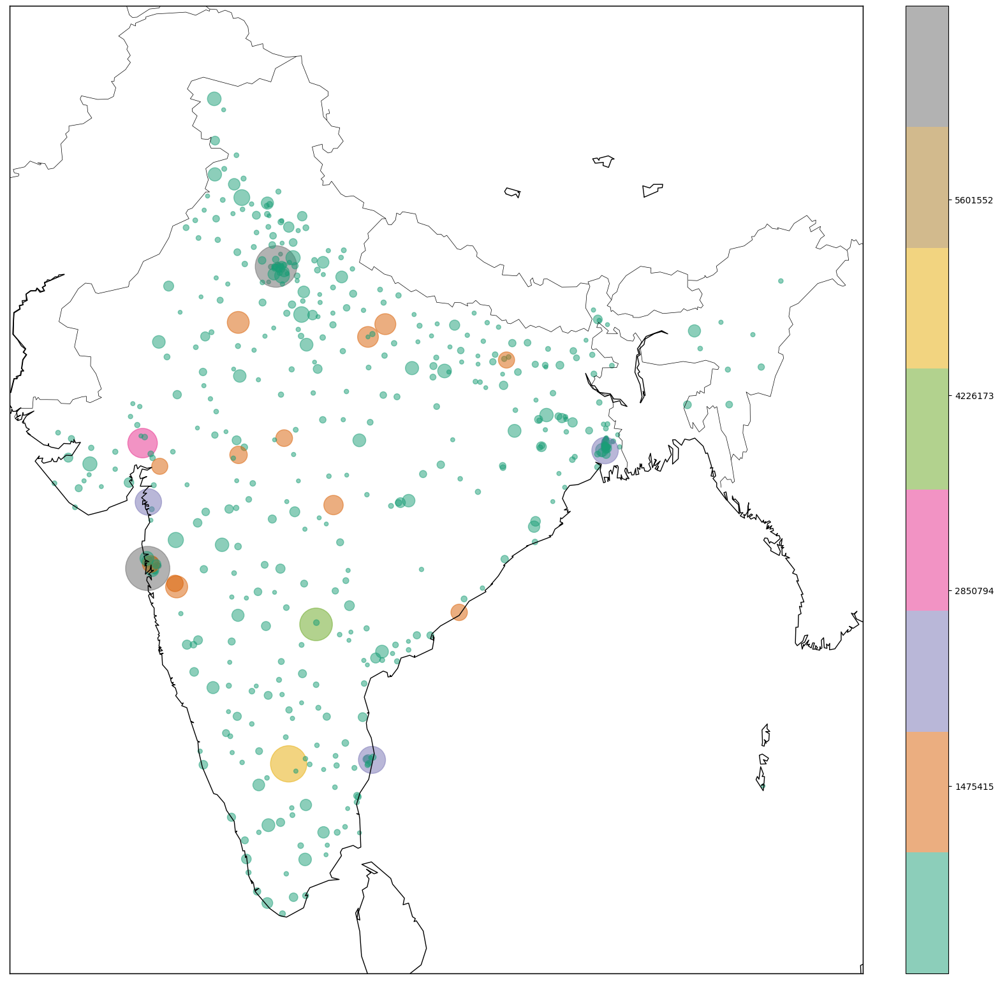

In [27]:

# Using the function created in the previous cell, we are plotting the population data

population_sizes = cities["population_total"].apply(lambda x: int(x / 5000))
colorbarValue = np.linspace(cities["population_total"].min(), cities["population_total"].max(), 
                            num=10)
colorbarValue = colorbarValue.astype(int)

plot_map(population_sizes, colorbarValue)

<ipython-input-28-b4371047fb95>:6: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='both', color='Black',linestyle='-')


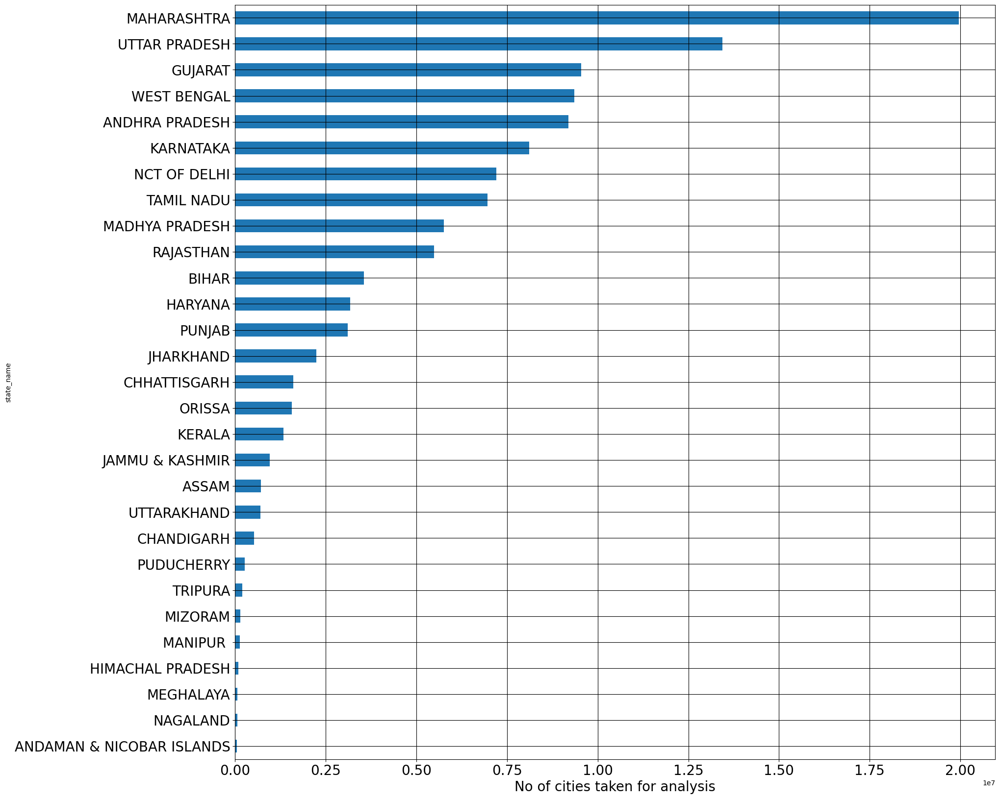

In [28]:
#Plotting Statewise cities to check which state have most male population
# A bar chart to show the male population of the states
fig = plt.figure(figsize=(20,20))
states = cities.groupby('state_name')['population_male'].sum().sort_values(ascending=True)
states.plot(kind="barh", fontsize = 20)
plt.grid(b=True, which='both', color='Black',linestyle='-')
plt.xlabel('No of cities taken for analysis', fontsize = 20)
plt.show ()
# we can see states like Maharashtra and UP have huge male population

<ipython-input-26-b595c5329cfa>:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(colorbarValue)


<Figure size 1900x2000 with 0 Axes>

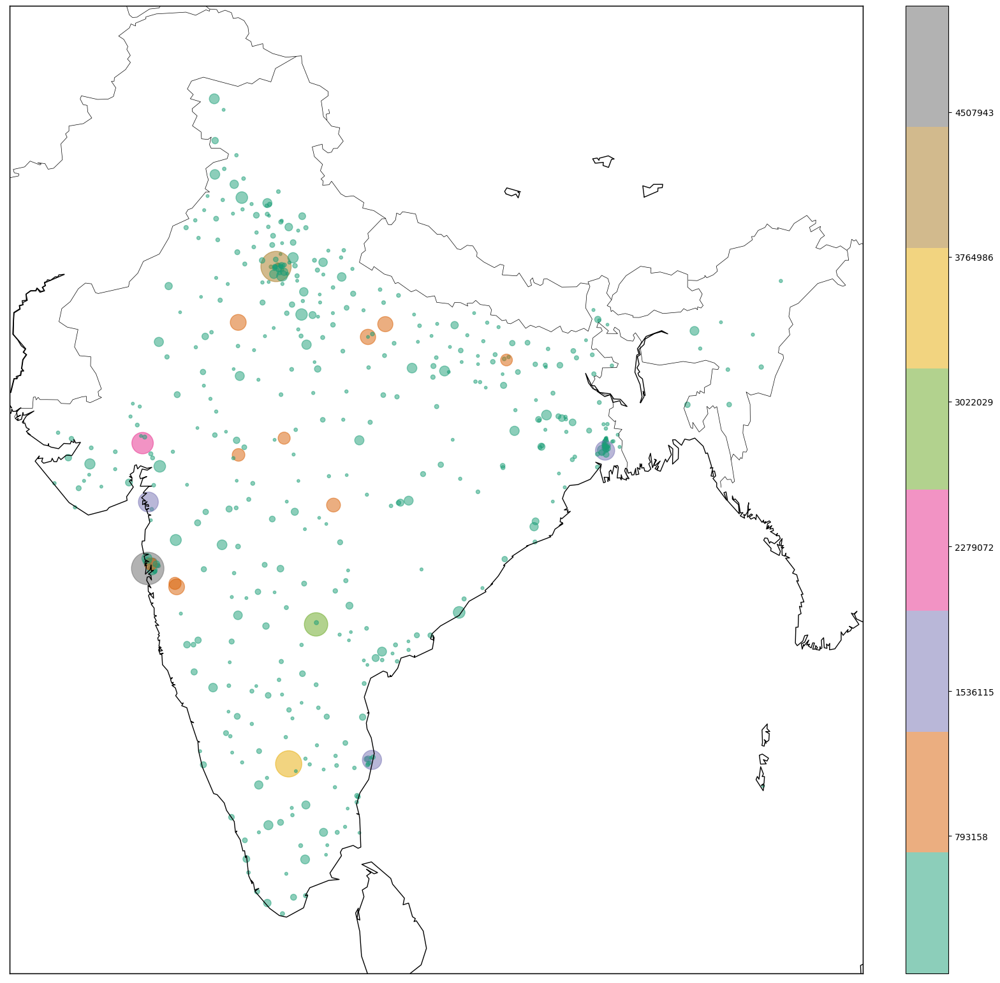

In [29]:
# Plotting the same on the map
population_sizes = cities["population_male"].apply(lambda x: int(x / 5000))
colorbarValue = np.linspace(cities["population_male"].min(), cities["population_male"].max(), 
                            num=10)
colorbarValue = colorbarValue.astype(int)

plot_map(population_sizes, colorbarValue)

In [30]:
#These are the top 10 cities with high male population
# A table to show top 10 cities with most male population
print("The Top 10 Cities sorted according to the Total Male Population (Descending Order)")
top_male_cities = cities.sort_values(by='population_male',ascending=False)
top10_male_pop_cities=top_male_cities.head(10)
top10_male_pop_cities


The Top 10 Cities sorted according to the Total Male Population (Descending Order)


,name_of_city,state_code,state_name,dist_code,population_total,population_male,population_female,0-6_population_total,0-6_population_male,0-6_population_female,...,child_sex_ratio,effective_literacy_rate_total,effective_literacy_rate_male,effective_literacy_rate_female,location,total_graduates,male_graduates,female_graduates,latitude,longitude
185,Greater Mumbai,27,MAHARASHTRA,99,12478447,6736815,5741632,1139146,599007,540139,...,902,90.28,93.32,86.70,"19.0760,72.8777",1802371,964964,837407,19.0760,72.8777
141,Delhi,7,NCT OF DELHI,99,11007835,5871362,5136473,1209275,647938,561337,...,866,87.60,91.44,83.20,"28.7041,77.1025",2221137,1210040,1011097,28.7041,77.1025
72,Bengaluru,29,KARNATAKA,18,8425970,4401299,4024671,862493,444639,417854,...,940,89.59,92.63,86.25,"12.9716,77.5946",1591163,908363,682800,12.9716,77.5946
184,Greater Hyderabad,28,ANDHRA PRADESH,99,6809970,3500802,3309168,725816,373794,352022,...,942,82.96,85.96,79.79,"17.3850,78.4867",1164149,685402,478747,17.3850,78.4867
7,Ahmadabad,24,GUJARAT,7,5570585,2935869,2634716,589076,317917,271159,...,853,89.62,93.96,84.81,"23.022505,72.5713621",769858,435267,334591,23.022505,72.5713621
449,Surat,24,GUJARAT,25,4462002,2538243,1923759,531522,293208,238314,...,813,89.03,92.76,84.05,"21.1702401,72.8310607",278795,160566,118229,21.1702401,72.8310607
274,Kolkata,19,WEST BENGAL,16,4486679,2362662,2124017,300052,155475,144577,...,930,87.14,89.08,84.98,"22.572646,88.363895",818476,461615,356861,22.572646,88.363895
119,Chennai,33,TAMIL NADU,2,4681087,2357633,2323454,418541,213084,205457,...,964,90.33,93.47,87.16,"13.0826802,80.2707184",879695,487428,392267,13.0826802,80.2707184
225,Jaipur,8,RAJASTHAN,12,3073350,1619280,1454070,378788,204320,174468,...,854,84.34,90.61,77.41,"26.9124336,75.7872709",533148,319107,214041,26.9124336,75.7872709
380,Pune,27,MAHARASHTRA,25,3115431,1602137,1513294,324572,171152,153420,...,896,91.61,95.13,87.91,"18.5204303,73.8567437",656508,349022,307486,18.5204303,73.8567437


<ipython-input-33-aceed382551c>:6: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='both', color='Black',linestyle='-')


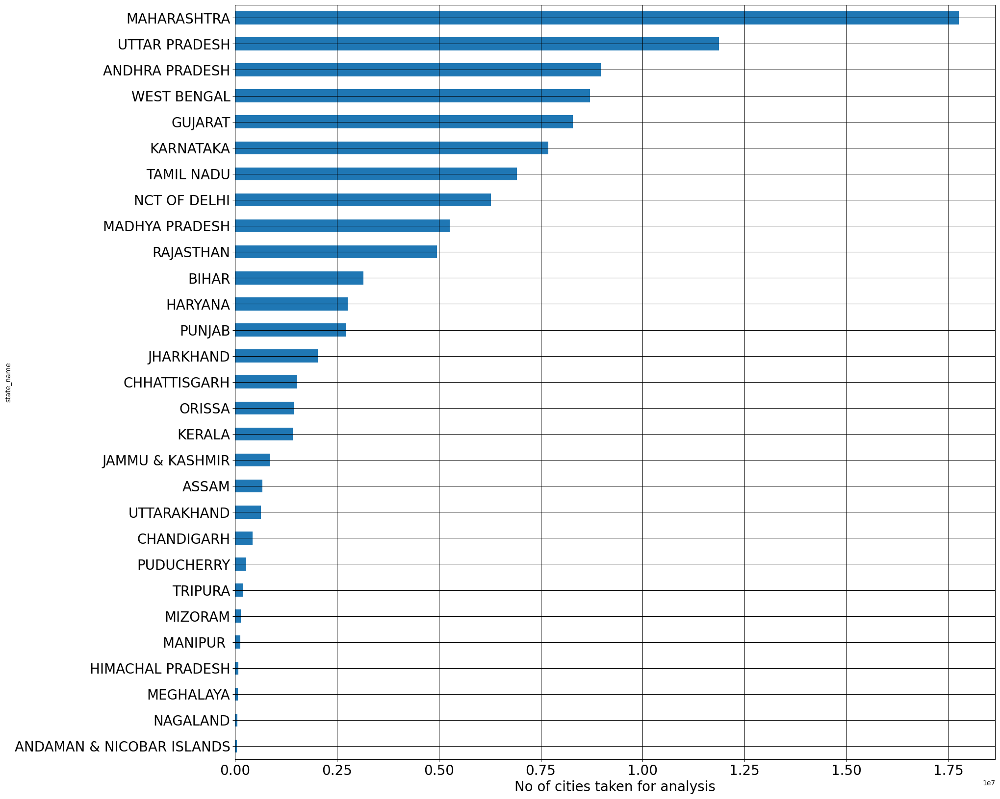

In [33]:
# Plotting Statewise cities to check which state have most female population
# A bar chart to show the female population of the states
fig = plt.figure(figsize=(20,20))
states = cities.groupby('state_name')['population_female'].sum().sort_values(ascending=True)
states.plot(kind="barh", fontsize = 20)
plt.grid(b=True, which='both', color='Black',linestyle='-')
plt.xlabel('No of cities taken for analysis', fontsize = 20)
plt.show ()
# we can see again states like Maharashtra and UP have huge female population

<ipython-input-26-b595c5329cfa>:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(colorbarValue)


<Figure size 1900x2000 with 0 Axes>

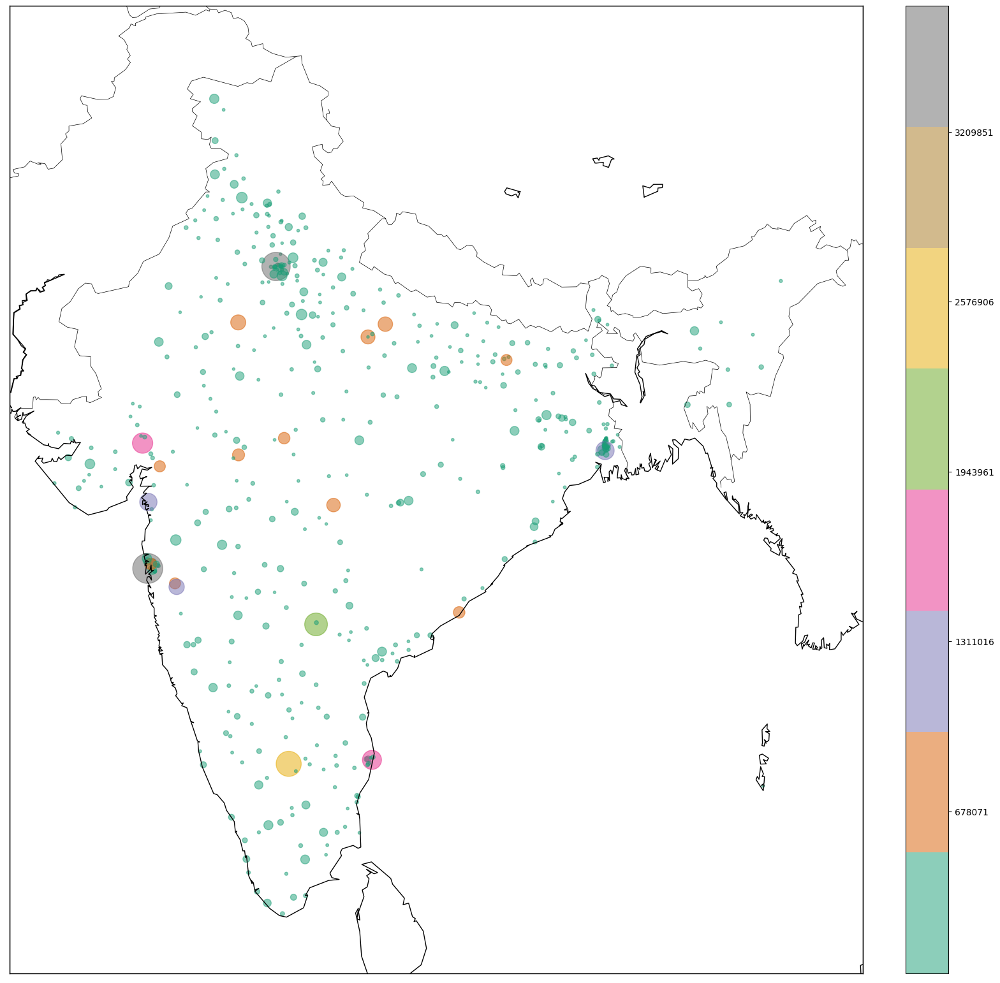

In [34]:
# Plotting the same on the map
population_sizes = cities["population_female"].apply(lambda x: int(x / 5000))
colorbarValue = np.linspace(cities["population_female"].min(), cities["population_female"].max(), 
                            num=10)
colorbarValue = colorbarValue.astype(int)

plot_map(population_sizes, colorbarValue)

Text(0.5, 1.0, 'Top 10 Male Populated Cities in India')

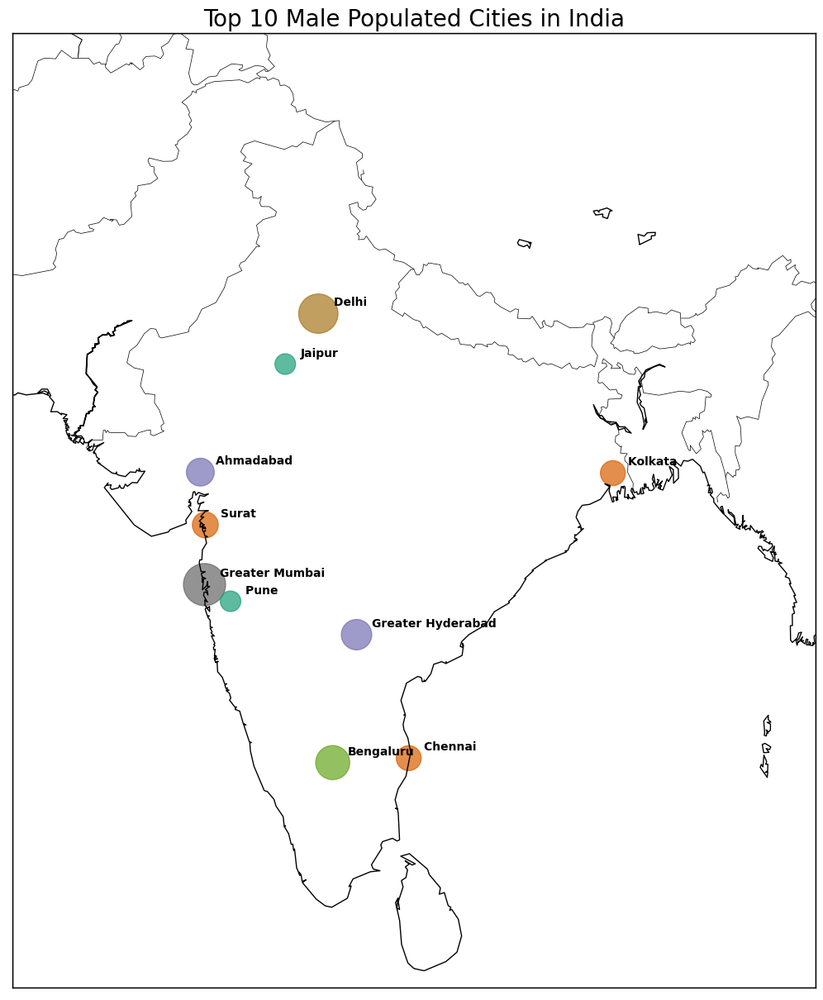

In [32]:
# Plotting these top 10 male populous cities on India map. Circles are sized according to the 
# male population of the respective city

plt.subplots(figsize=(20, 15))
map = Basemap(width=1200000,height=900000,projection='lcc',resolution='l',
                    llcrnrlon=67,llcrnrlat=5,urcrnrlon=99,urcrnrlat=37,lat_0=28,lon_0=77)

map.drawmapboundary ()
map.drawcountries ()
map.drawcoastlines ()

lg=array(top10_male_pop_cities['longitude'])
lt=array(top10_male_pop_cities['latitude'])
pt=array(top10_male_pop_cities['population_male'])
nc=array(top10_male_pop_cities['name_of_city'])

x, y = map(lg, lt)
population_sizes_male = top10_male_pop_cities["population_male"].apply(lambda x: int(x / 5000))
plt.scatter(x, y, s=population_sizes_male, marker="o", c=population_sizes_male, cmap=cm.Dark2, alpha=0.7)


for ncs, xpt, ypt in zip(nc, x, y):
    plt.text(xpt+60000, ypt+30000, ncs, fontsize=10, fontweight='bold')

plt.title('Top 10 Male Populated Cities in India',fontsize=20)

<ipython-input-35-868dab8a5999>:6: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='both', color='Black',linestyle='-')


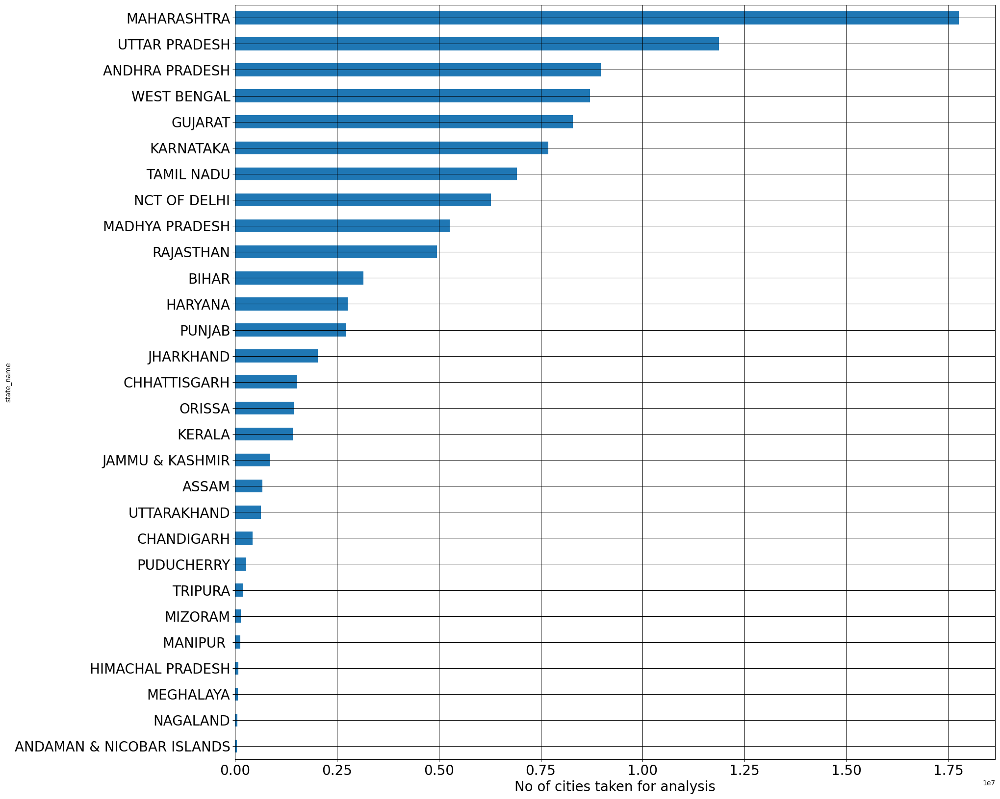

In [35]:
#Plotting Statewise cities to check which state have most female population
# A bar chart to show the female population of the states
fig = plt.figure(figsize=(20,20))
states = cities.groupby('state_name')['population_female'].sum().sort_values(ascending=True)
states.plot(kind="barh", fontsize = 20)
plt.grid(b=True, which='both', color='Black',linestyle='-')
plt.xlabel('No of cities taken for analysis', fontsize = 20)
plt.show ()
# we can see again states like Maharashtra and UP have huge female population

<ipython-input-26-b595c5329cfa>:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(colorbarValue)


<Figure size 1900x2000 with 0 Axes>

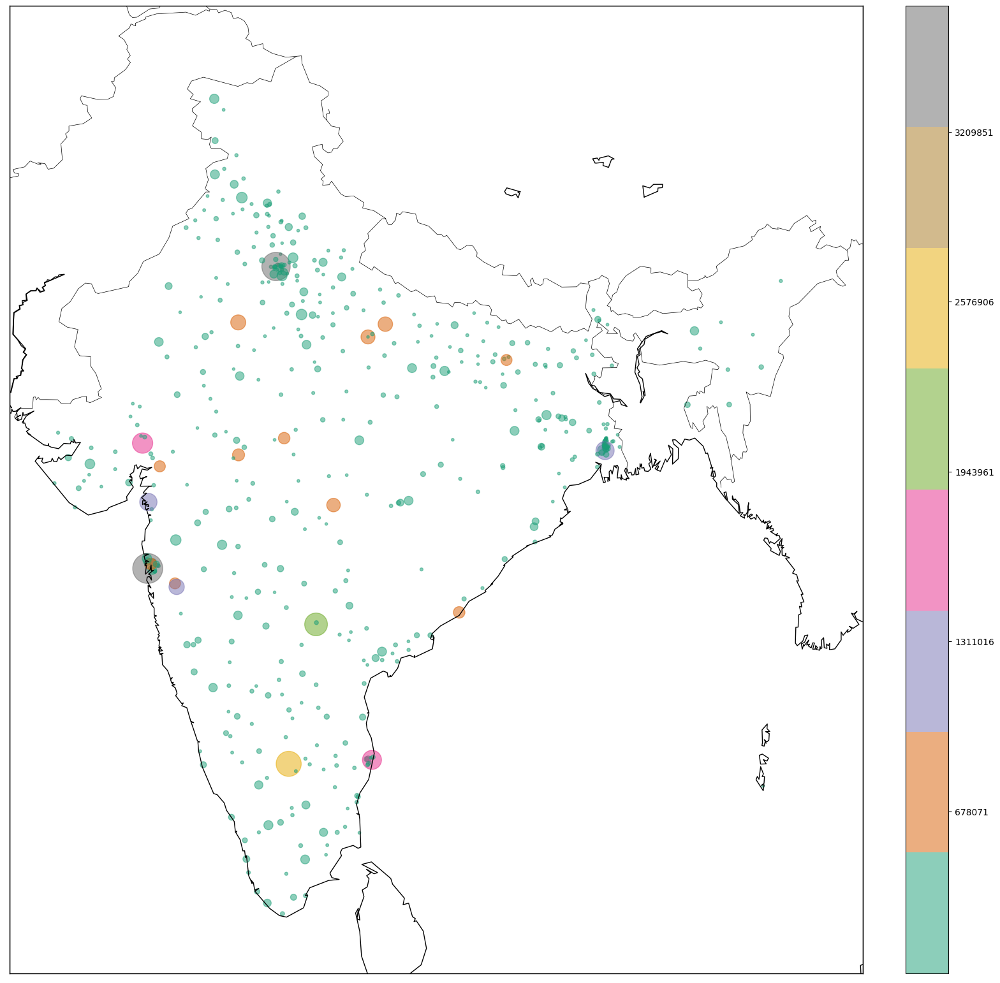

In [36]:
# Plotting the same on the map
population_sizes = cities["population_female"].apply(lambda x: int(x / 5000))
colorbarValue = np.linspace(cities["population_female"].min(), cities["population_female"].max(), 
                            num=10)
colorbarValue = colorbarValue.astype(int)

plot_map(population_sizes, colorbarValue)

In [38]:
#These are the top 10 cities with high female population
# A table to show top 10 cities with most female population
print("The Top 10 Cities sorted according to the Total Female Population (Descending Order)")
top_female_cities = cities.sort_values(by='population_female',ascending=False)
top10_female_pop_cities=top_female_cities.head(10)
top10_female_pop_cities

The Top 10 Cities sorted according to the Total Female Population (Descending Order)


,name_of_city,state_code,state_name,dist_code,population_total,population_male,population_female,0-6_population_total,0-6_population_male,0-6_population_female,...,child_sex_ratio,effective_literacy_rate_total,effective_literacy_rate_male,effective_literacy_rate_female,location,total_graduates,male_graduates,female_graduates,latitude,longitude
185,Greater Mumbai,27,MAHARASHTRA,99,12478447,6736815,5741632,1139146,599007,540139,...,902,90.28,93.32,86.70,"19.0760,72.8777",1802371,964964,837407,19.0760,72.8777
141,Delhi,7,NCT OF DELHI,99,11007835,5871362,5136473,1209275,647938,561337,...,866,87.60,91.44,83.20,"28.7041,77.1025",2221137,1210040,1011097,28.7041,77.1025
72,Bengaluru,29,KARNATAKA,18,8425970,4401299,4024671,862493,444639,417854,...,940,89.59,92.63,86.25,"12.9716,77.5946",1591163,908363,682800,12.9716,77.5946
184,Greater Hyderabad,28,ANDHRA PRADESH,99,6809970,3500802,3309168,725816,373794,352022,...,942,82.96,85.96,79.79,"17.3850,78.4867",1164149,685402,478747,17.3850,78.4867
7,Ahmadabad,24,GUJARAT,7,5570585,2935869,2634716,589076,317917,271159,...,853,89.62,93.96,84.81,"23.022505,72.5713621",769858,435267,334591,23.022505,72.5713621
119,Chennai,33,TAMIL NADU,2,4681087,2357633,2323454,418541,213084,205457,...,964,90.33,93.47,87.16,"13.0826802,80.2707184",879695,487428,392267,13.0826802,80.2707184
274,Kolkata,19,WEST BENGAL,16,4486679,2362662,2124017,300052,155475,144577,...,930,87.14,89.08,84.98,"22.572646,88.363895",818476,461615,356861,22.572646,88.363895
449,Surat,24,GUJARAT,25,4462002,2538243,1923759,531522,293208,238314,...,813,89.03,92.76,84.05,"21.1702401,72.8310607",278795,160566,118229,21.1702401,72.8310607
380,Pune,27,MAHARASHTRA,25,3115431,1602137,1513294,324572,171152,153420,...,896,91.61,95.13,87.91,"18.5204303,73.8567437",656508,349022,307486,18.5204303,73.8567437
225,Jaipur,8,RAJASTHAN,12,3073350,1619280,1454070,378788,204320,174468,...,854,84.34,90.61,77.41,"26.9124336,75.7872709",533148,319107,214041,26.9124336,75.7872709


Text(0.5, 1.0, 'Top 10 Female Populated Cities in India')

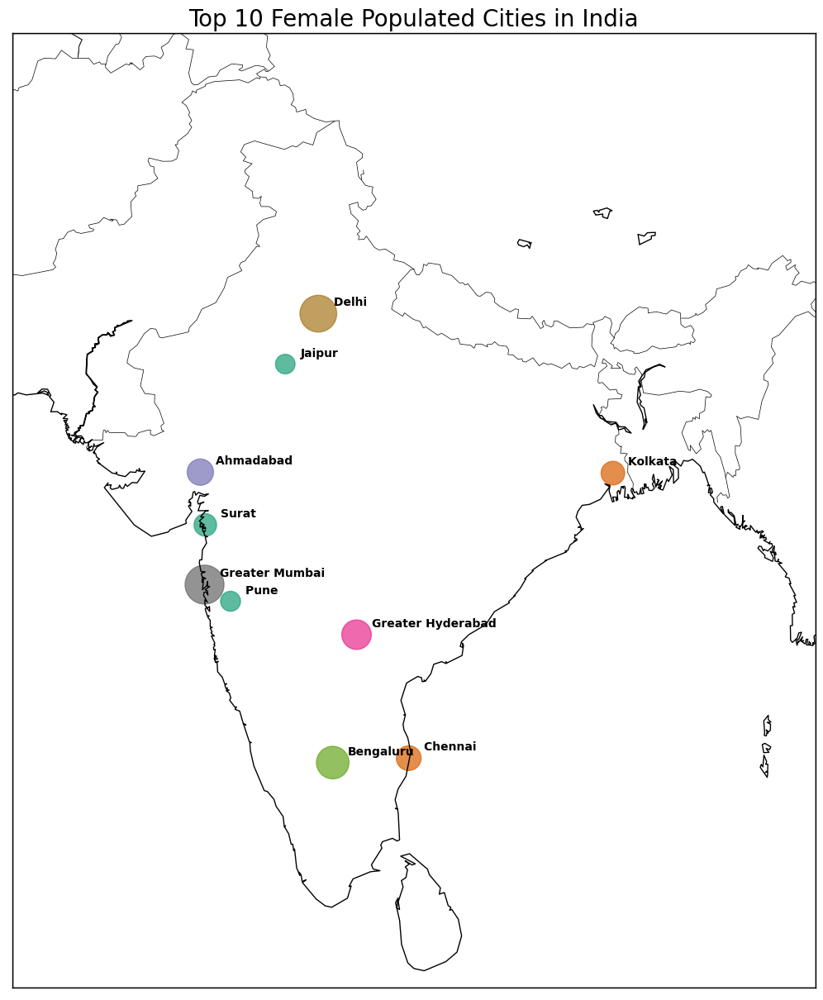

In [39]:
# Plotting these top 10 female populous cities on India map. Circles are sized according to the 
# female population of the respective city

plt.subplots(figsize=(20, 15))
map = Basemap(width=1200000,height=900000,projection='lcc',resolution='l',
                    llcrnrlon=67,llcrnrlat=5,urcrnrlon=99,urcrnrlat=37,lat_0=28,lon_0=77)

map.drawmapboundary ()
map.drawcountries ()
map.drawcoastlines ()

lg=array(top10_female_pop_cities['longitude'])
lt=array(top10_female_pop_cities['latitude'])
pt=array(top10_female_pop_cities['population_female'])
nc=array(top10_female_pop_cities['name_of_city'])

x, y = map(lg, lt)
population_sizes_female = top10_female_pop_cities["population_female"].apply(lambda x: int(x / 5000))
plt.scatter(x, y, s=population_sizes_female, marker="o", c=population_sizes_female, cmap=cm.Dark2, alpha=0.7)


for ncs, xpt, ypt in zip(nc, x, y):
    plt.text(xpt+60000, ypt+30000, ncs, fontsize=10, fontweight='bold')

plt.title('Top 10 Female Populated Cities in India',fontsize=20)


<ipython-input-40-ec331c9206cf>:6: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='both', color='Black',linestyle='-')


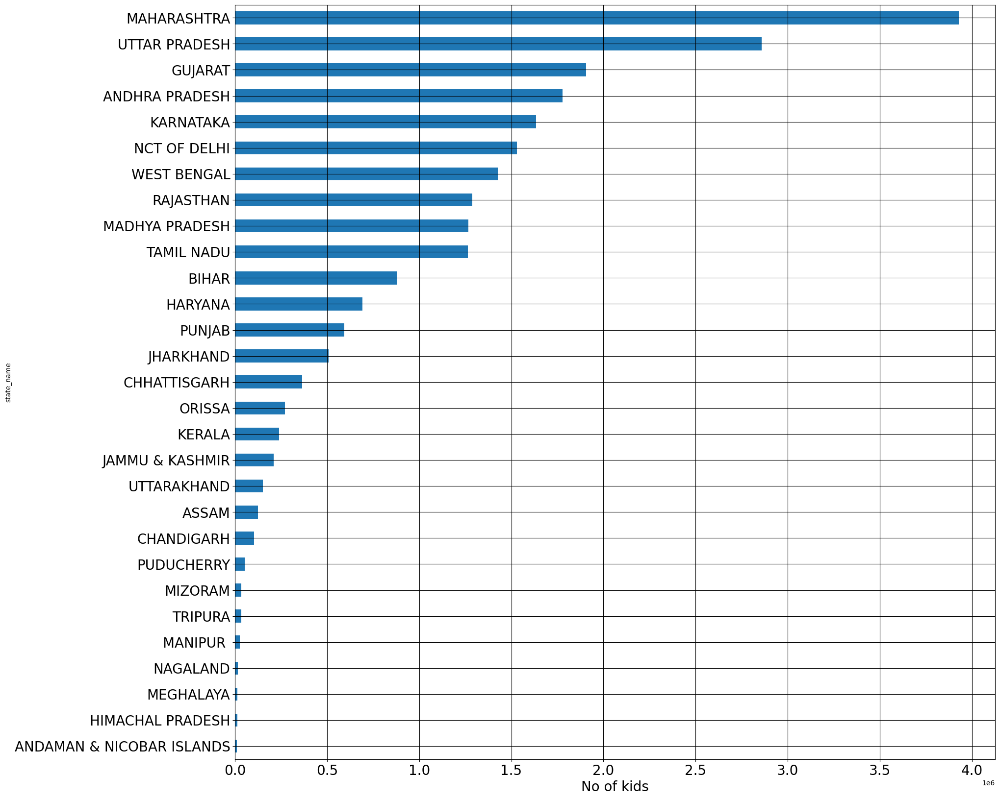

In [40]:
#Plotting Statewise cities to check which state have most Kids (aged between 0 to 6) population
# A bar chart to show the kids population of the states
fig = plt.figure(figsize=(20,20))
states = cities.groupby('state_name')['0-6_population_total'].sum().sort_values(ascending=True)
states.plot(kind="barh", fontsize = 20)
plt.grid(b=True, which='both', color='Black',linestyle='-')
plt.xlabel('No of kids', fontsize = 20)
plt.show ()
# we can see again states like Maharashtra and UP have huge kids population living in cities

<ipython-input-26-b595c5329cfa>:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(colorbarValue)


<Figure size 1900x2000 with 0 Axes>

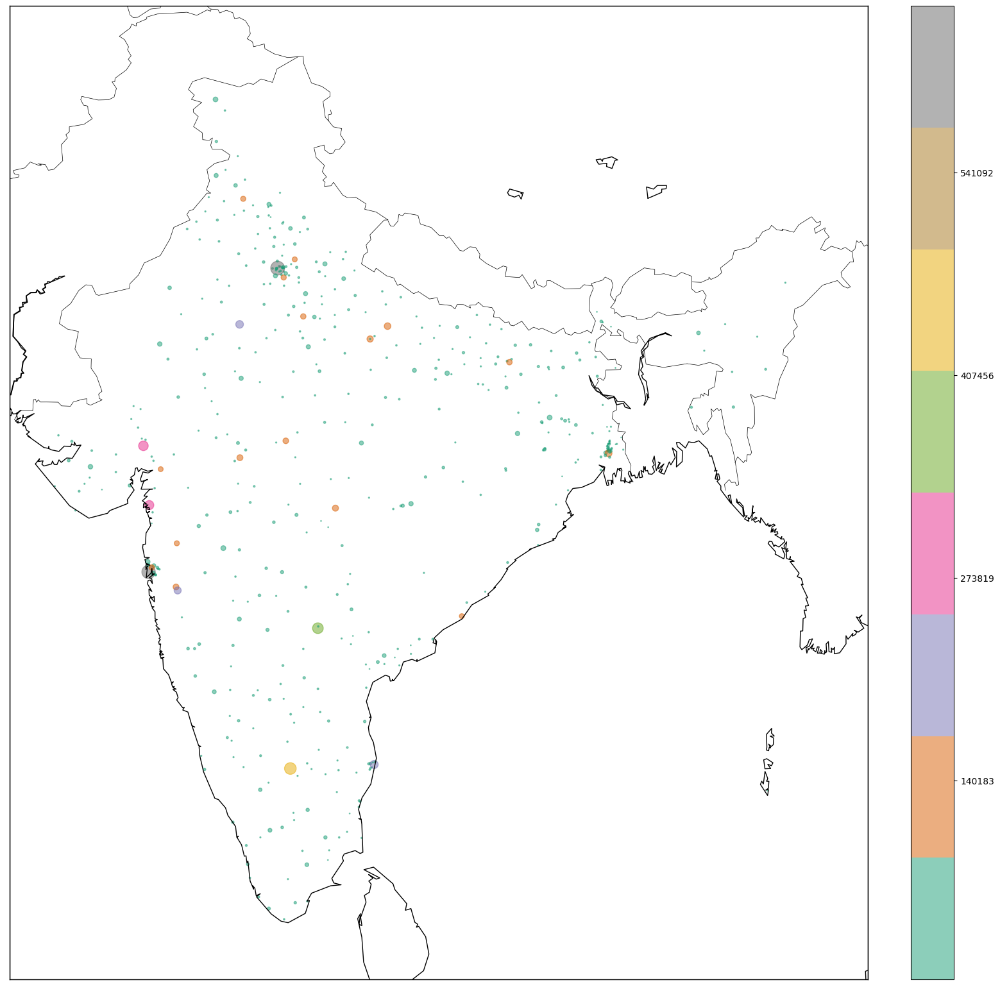

In [41]:
# Plotting the same on the map
population_sizes = cities["0-6_population_total"].apply(lambda x: int(x / 5000))
colorbarValue = np.linspace(cities["0-6_population_total"].min(), cities["0-6_population_total"].max(), 
                            num=10)
colorbarValue = colorbarValue.astype(int)

plot_map(population_sizes, colorbarValue)
# Kids population is obviously smaller than the overall population and bigger cities like Delhi,
# Mumbai, Banglore, Kolkata, Hyderabad, Chennai have vast number of kids living in cities

In [43]:
#Top 10 cities where most of the kids live
# Lets find the top ten cities in which large number of kids live
print("The Top 10 Cities sorted according to the Total Kids Population (Descending Order)")
top_kids_cities = cities.sort_values(by='0-6_population_total',ascending=False)
top10_kids_pop_cities=top_kids_cities.head(10)
top10_kids_pop_cities

The Top 10 Cities sorted according to the Total Kids Population (Descending Order)


,name_of_city,state_code,state_name,dist_code,population_total,population_male,population_female,0-6_population_total,0-6_population_male,0-6_population_female,...,child_sex_ratio,effective_literacy_rate_total,effective_literacy_rate_male,effective_literacy_rate_female,location,total_graduates,male_graduates,female_graduates,latitude,longitude
141,Delhi,7,NCT OF DELHI,99,11007835,5871362,5136473,1209275,647938,561337,...,866,87.60,91.44,83.20,"28.7041,77.1025",2221137,1210040,1011097,28.7041,77.1025
185,Greater Mumbai,27,MAHARASHTRA,99,12478447,6736815,5741632,1139146,599007,540139,...,902,90.28,93.32,86.70,"19.0760,72.8777",1802371,964964,837407,19.0760,72.8777
72,Bengaluru,29,KARNATAKA,18,8425970,4401299,4024671,862493,444639,417854,...,940,89.59,92.63,86.25,"12.9716,77.5946",1591163,908363,682800,12.9716,77.5946
184,Greater Hyderabad,28,ANDHRA PRADESH,99,6809970,3500802,3309168,725816,373794,352022,...,942,82.96,85.96,79.79,"17.3850,78.4867",1164149,685402,478747,17.3850,78.4867
7,Ahmadabad,24,GUJARAT,7,5570585,2935869,2634716,589076,317917,271159,...,853,89.62,93.96,84.81,"23.022505,72.5713621",769858,435267,334591,23.022505,72.5713621
449,Surat,24,GUJARAT,25,4462002,2538243,1923759,531522,293208,238314,...,813,89.03,92.76,84.05,"21.1702401,72.8310607",278795,160566,118229,21.1702401,72.8310607
119,Chennai,33,TAMIL NADU,2,4681087,2357633,2323454,418541,213084,205457,...,964,90.33,93.47,87.16,"13.0826802,80.2707184",879695,487428,392267,13.0826802,80.2707184
225,Jaipur,8,RAJASTHAN,12,3073350,1619280,1454070,378788,204320,174468,...,854,84.34,90.61,77.41,"26.9124336,75.7872709",533148,319107,214041,26.9124336,75.7872709
380,Pune,27,MAHARASHTRA,25,3115431,1602137,1513294,324572,171152,153420,...,896,91.61,95.13,87.91,"18.5204303,73.8567437",656508,349022,307486,18.5204303,73.8567437
274,Kolkata,19,WEST BENGAL,16,4486679,2362662,2124017,300052,155475,144577,...,930,87.14,89.08,84.98,"22.572646,88.363895",818476,461615,356861,22.572646,88.363895


Text(0.5, 1.0, 'Top 10 Kids Populated Cities in India')

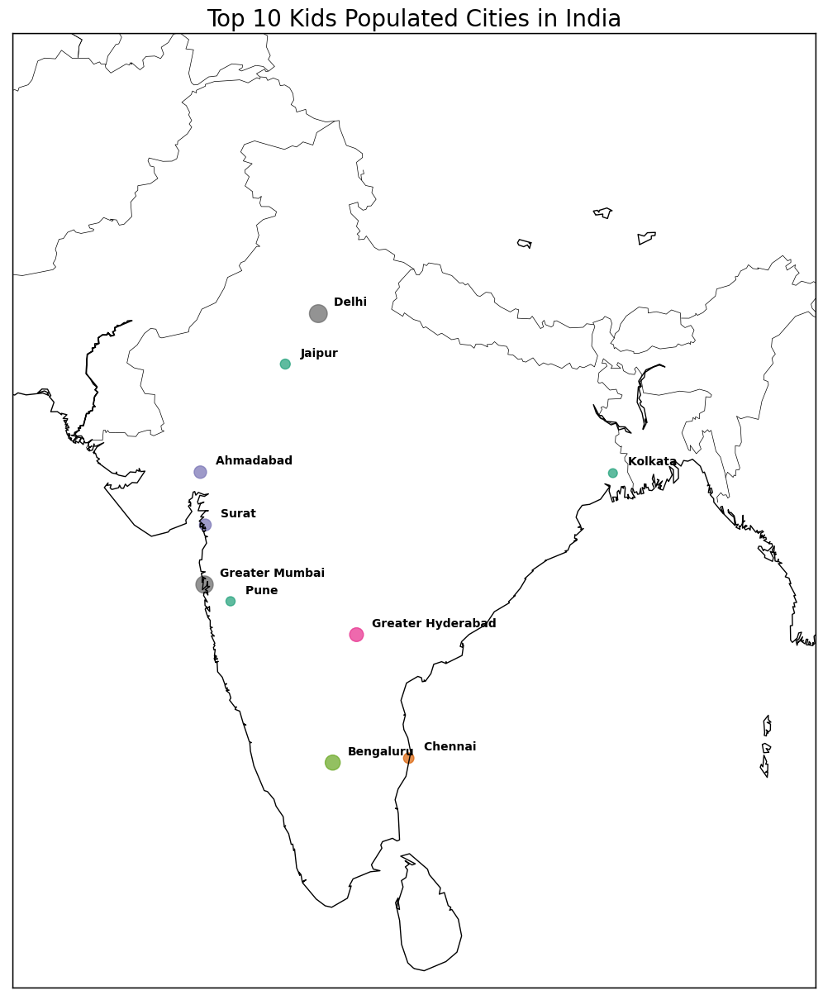

In [44]:
# Lets find the top ten cities in which large number of kids live

plt.subplots(figsize=(20, 15))
map = Basemap(width=1200000,height=900000,projection='lcc',resolution='l',
                    llcrnrlon=67,llcrnrlat=5,urcrnrlon=99,urcrnrlat=37,lat_0=28,lon_0=77)

map.drawmapboundary ()
map.drawcountries ()
map.drawcoastlines ()

lg=array(top10_kids_pop_cities['longitude'])
lt=array(top10_kids_pop_cities['latitude'])
pt=array(top10_kids_pop_cities['0-6_population_total'])
nc=array(top10_kids_pop_cities['name_of_city'])

x, y = map(lg, lt)
population_sizes_kids = top10_kids_pop_cities["0-6_population_total"].apply(lambda x: int(x / 5000))
plt.scatter(x, y, s=population_sizes_kids, marker="o", c=population_sizes_kids, cmap=cm.Dark2, alpha=0.7)


for ncs, xpt, ypt in zip(nc, x, y):
    plt.text(xpt+60000, ypt+30000, ncs, fontsize=10, fontweight='bold')

plt.title('Top 10 Kids Populated Cities in India',fontsize=20)

<ipython-input-45-b3bd2f7579d2>:6: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='both', color='Black',linestyle='-')


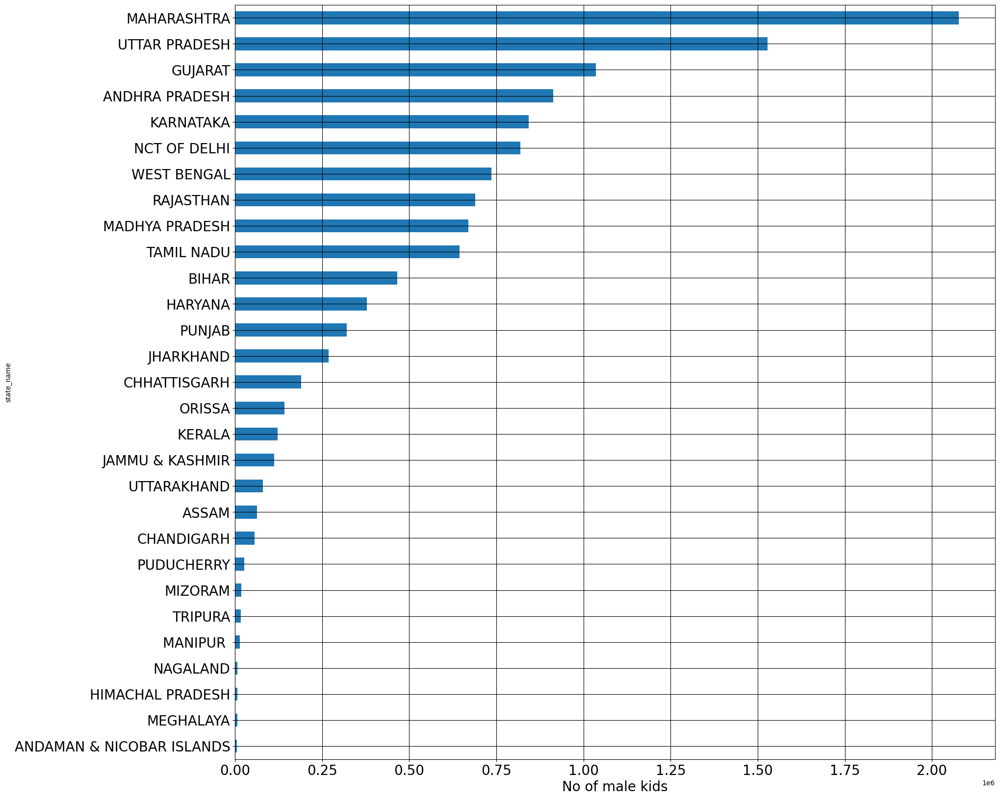

In [45]:
#Plotting Statewise cities to check which state have most Male Kids (aged between 0 to 6) population
# A bar chart to show the male kids population of the states
fig = plt.figure(figsize=(20,20))
states = cities.groupby('state_name')['0-6_population_male'].sum().sort_values(ascending=True)
states.plot(kind="barh", fontsize = 20)
plt.grid(b=True, which='both', color='Black',linestyle='-')
plt.xlabel('No of male kids', fontsize = 20)
plt.show ()
# we can see again states like Maharashtra and UP have huge male kids population living in cities

<ipython-input-26-b595c5329cfa>:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(colorbarValue)


<Figure size 1900x2000 with 0 Axes>

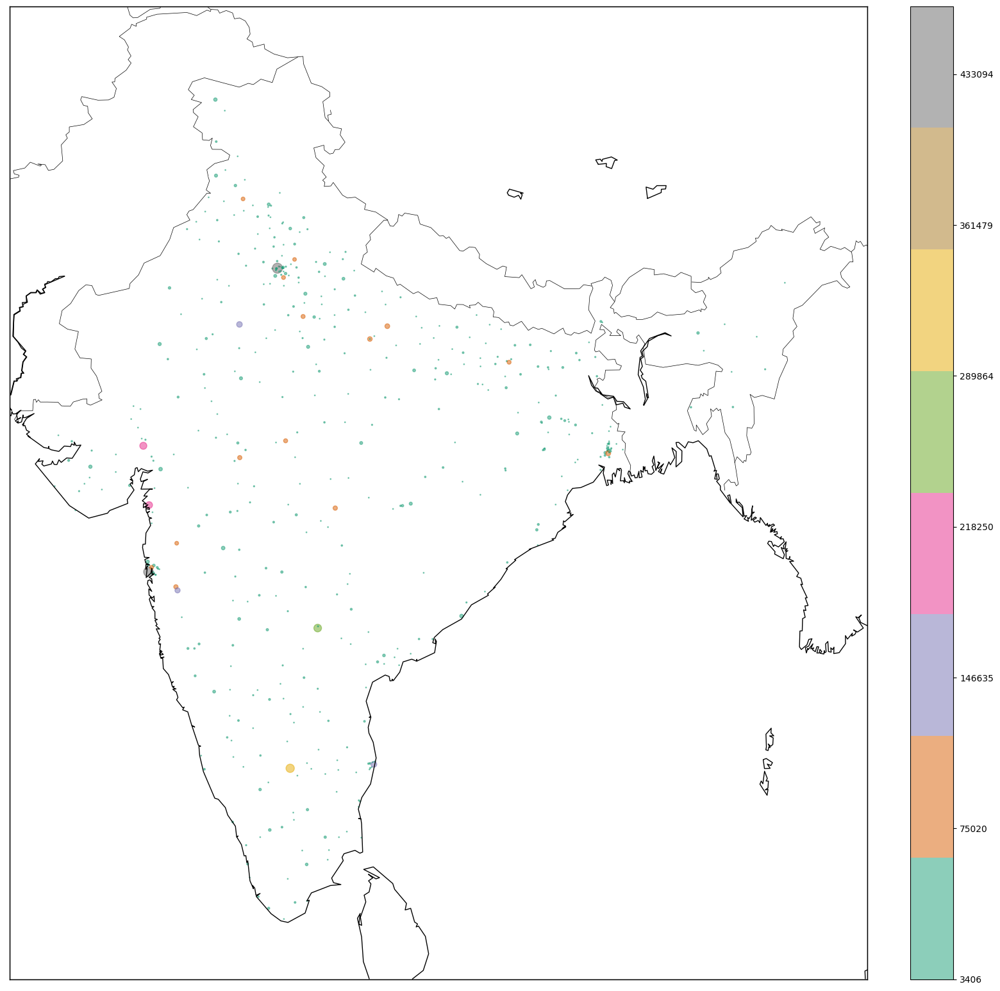

In [46]:
# Plotting the same on the map
population_sizes = cities["0-6_population_male"].apply(lambda x: int(x / 5000))
colorbarValue = np.linspace(cities["0-6_population_male"].min(), cities["0-6_population_male"].max(), 
                            num=10)
colorbarValue = colorbarValue.astype(int)

plot_map(population_sizes, colorbarValue)
# Kids population is obviously smaller than the overall population and bigger cities like Delhi,
# Mumbai, Banglore, Kolkata, Hyderabad, Chennai have vast number of kids living in cities

Insights
Uttar Pradesh and West Bengal are the two states from which most of the cities were taken, followed by Maharashtra and Andhra Pradesh.

Greater Mumbai, Delhi, Bengaluru are the top most populous cities of India in that order.

Maharashtra, Uttar Pradesh and Andhra Pradesh are the top 3 states, where most of the people lives in urban areas.

Maharashtra is the only state that have most of the male, female, male kids, female kids population living in urban areas.

Greater Mumbai is the most populated city in India (both men and women)

Delhi is the top most city that have high kids population